---
title: "Make predictions directly from SPI tree"

author: "Benjamin Doran"

date: today

---

## Setup

In [1]:
using DrWatson
@quickactivate "Doran_etal_2022"

using SPI, MLJ
using MLJBase: train_test_pairs
using Clustering, Distances
using Muon, CSV, DataFrames
using StatsPlots, StatsBase
using NewickTree, NewickTreeTools
using Gotree_jll

using Distances
using NearestNeighbors

function getlims(x, y) 
    lims = extrema(vcat(x, y))
    lims =  lims .+ (-(lims[2] - lims[1]) * 0.1, (lims[2] - lims[1]) * 0.1)
end

Base.@kwdef struct GroupedEuclidean{T} <: Metric
    groups::Vector{T}
end
function (dist::GroupedEuclidean)(r, a, b)
    for grp in dist.groups
        r += sqrt(sum(abs2.(a[grp] .- b[grp])))
    end
    r
end
function (dist::GroupedEuclidean)(a, b)
    r = zero(eltype(a))
    dist(r, a, b)
end
function (dist::GroupedEuclidean)(a::Number, b::Number)
    euclidean(a, b)
end
groupedeuclidean(a, b, intervals=collect(axes(a,1))) = GroupedEuclidean(intervals)(a, b)
groupedeuclidean!(r, a, b, intervals=collect(axes(a,1))) = GroupedEuclidean(intervals)(r, a, b)

groupedeuclidean! (generic function with 2 methods)

In [2]:
ddir = datadir("exp_pro", "BB728")
rdir = projectdir("_research", "metabolite_knn_model") |> mkpath
pdir = plotsdir("metabolite_knn_model") |> mkpath
biobank = readh5mu(joinpath(ddir, "BB728.h5mu"))

┌ Warning: Cannot join columns with the same name because var_names are intersecting.
└ @ Muon /Users/ben/.julia/packages/Muon/eLqpV/src/mudata.jl:351


MuData object 728 ✕ 21485
└ metabolites_foldchange
  AnnData object 728 ✕ 50
└ metabolites_millimolar
  AnnData object 728 ✕ 10
└ UPorder_oggs
  AnnData object 728 ✕ 10177
└ oggs
  AnnData object 728 ✕ 11248

In [3]:
trn_mask = biobank.obs.inBB673 .== 1
tst_mask = biobank.obs.inBB673 .== 0
trn_mtx = biobank["UPorder_oggs"].X[:,:][trn_mask, :]
tst_mtx = biobank["UPorder_oggs"].X[:,:][tst_mask, :];
mtx = biobank["UPorder_oggs"].X[:,:];

In [4]:
bbusv = SVD(
    biobank["UPorder_oggs"].obsm["inferredLSVs"][:,:],
    biobank["UPorder_oggs"].uns["UP_SVs"][:],
    biobank["UPorder_oggs"].varm["UP_RSVs"][:, :]',
    );
norm(mtx .- projectout(bbusv)) / norm(mtx)

0.03065109952898508

In [5]:
sigresdf = CSV.read(joinpath(ddir, "significant_metabolites_in_subsetSPItree_numisolatesperspecies=+20.csv"), DataFrame)

earlytreesigmetabolitesdf = filter(:node_depth_maxeffect => >(3.5), sigresdf) |>
    df -> groupby(df, :metabolite_name) |>
    df -> combine(df, :effect_size_abs => maximum) |>
    df -> sort(df, :effect_size_abs_maximum, rev=true)
middletreesigmetabolitesdf = filter(:node_depth_maxeffect => (x)-> 2 .< x .< 3.5, sigresdf) |>
    df -> groupby(df, :metabolite_name) |>
    df -> combine(df, :effect_size_abs => maximum) |>
    df -> sort(df, :effect_size_abs_maximum, rev=true)
latetreesigmetabolitesdf = filter(:node_depth_maxeffect => <(2), sigresdf) |>
    df -> groupby(df, :metabolite_name) |>
    df -> combine(df, :effect_size_abs => maximum) |>
    df -> sort(df, :effect_size_abs_maximum, rev=true);

metabolite_has_effectsize_mask = vcat(
    earlytreesigmetabolitesdf,
    middletreesigmetabolitesdf,
    latetreesigmetabolitesdf,
).effect_size_abs_maximum .> 0.6;

orderedmetabolites_names = vcat(
    earlytreesigmetabolitesdf.metabolite_name,
    middletreesigmetabolitesdf.metabolite_name,
    latetreesigmetabolitesdf.metabolite_name,
);
metabolite_mask_ord_early = indexin(earlytreesigmetabolitesdf.metabolite_name, replace.(biobank["metabolites_foldchange"].var_names, "_rel"=>""));
metabolite_mask_ord_middle = indexin(middletreesigmetabolitesdf.metabolite_name, replace.(biobank["metabolites_foldchange"].var_names, "_rel"=>""));
metabolite_mask_ord_late = indexin(latetreesigmetabolitesdf.metabolite_name, replace.(biobank["metabolites_foldchange"].var_names, "_rel"=>""));
metabolite_mask_ord = indexin(orderedmetabolites_names, replace.(biobank["metabolites_foldchange"].var_names, "_rel"=>""));

In [6]:
bb_met_lfc = biobank["metabolites_foldchange"].X[:, :];
bb_met_lfc[isinf.(bb_met_lfc)] .= 0.0;
metabolicdistance = pairwise(Euclidean(), bb_met_lfc; dims=1);

In [33]:
metabolicallyvariabledf = biobank.obs[trn_mask, :] |>
    df->DataFrames.transform(df, eachindex => :rowid) |>
    df->groupby(df, :species) |>
    df->combine(df, 
        nrow => :num_isolates, 
        :rowid => ((x)->maximum(metabolicdistance[x,x])) => :max_metabolicdistance,
        :rowid => ((x)->maximum(metabolicdistance[x,x]) > 20) => :isvariable,
        ) |>
    df->filter(:num_isolates => >=(10), df) |>
    df->sort(df, [:max_metabolicdistance, :num_isolates], rev=true)

specieswith20reps = metabolicallyvariabledf |>
    df -> filter(:num_isolates => >=(20), df) |>
    df -> filter(:species => !=("unclassified"), df) |>
    df -> sort(df, :num_isolates, rev=true)


spe20rep_mask = .!isnothing.(indexin(biobank.obs.species[trn_mask], specieswith20reps.species));

In [34]:
full_train_mask = zeros(Bool, 728)
full_train_mask[trn_mask] .= spe20rep_mask;

full_test_mask = ones(Bool, 728)
full_test_mask[trn_mask] = .!spe20rep_mask
sum(full_train_mask), sum(full_test_mask)

(356, 372)

In [35]:
bbmtx = biobank["oggs"].X[:, :]
bbmtx_trn = bbmtx[full_train_mask, :]
bbmtx_tst = bbmtx[full_test_mask, :]
# filter out oggs that are constant
ogg_mask = vec(mapslices(c->std(c) > 0, bbmtx_trn, dims=1))
bbmtx_trn = bbmtx_trn[:, ogg_mask]
bbmtx_tst = bbmtx_tst[:, ogg_mask]
zbbmtx_trn = mapslices(StatsBase.zscore, bbmtx_trn, dims=1)
zbbmtx_tst = mapslices(StatsBase.zscore, bbmtx_tst, dims=1)
replace!(zbbmtx_tst, NaN=>0.) # replace zscored NaNs with zeros (it's what they were before)
bbusv_internal = svd(zbbmtx_trn)
BBUinternal_tst = projectinLSV(zbbmtx_tst, bbusv_internal)
BBpcs_trn = bbusv_internal.U * diagm(bbusv_internal.S)
BBpcs_tst = BBUinternal_tst * diagm(bbusv_internal.S);

In [36]:
biobank.obs[!, "species_donor"] = biobank.obs.species .* "_" .* biobank.obs.donor
bbobs_trn = biobank.obs[full_train_mask, :]
bbobs_tst = biobank.obs[full_test_mask, :];

In [37]:
subsetDij = biobank["UPorder_oggs"].obsp["SDij"][full_train_mask, full_train_mask];
subsettree_hc = hclust(subsetDij, linkage=:average, branchorder=:optimal)
subsettreestring = SPI.nwstr(subsettree_hc, bbobs_trn.ID; labelinternalnodes=false)
subsettree = readnw(subsettreestring);

In [38]:
trnX = mtx[full_train_mask, :]
trnYdf = bbobs_trn;

metab_trnY = bb_met_lfc[full_train_mask, metabolite_mask_ord];
metab_tstY = bb_met_lfc[full_test_mask, metabolite_mask_ord];

measurable_metabolites_mask = mapslices(c->mean(c .==0.) < .9, metab_trnY, dims=1)|>vec;
keepmetabolites_mask = measurable_metabolites_mask .& metabolite_has_effectsize_mask

PCs_trnX = DataFrame(BBpcs_trn[:, 1:10], :auto);
PCs_tstX = DataFrame(BBpcs_tst[:, 1:10], :auto);

In [39]:
specieslabels = [
    "Bacteroides uniformis",
    "Phocaeicola vulgatus",
    "Bacteroides thetaiotaomicron",
    "[Ruminococcus] gnavus",
    "Bifidobacterium breve",
    "[Eubacterium] rectale",
    "Dorea formicigenerans",
    "Coprococcus comes",
    "Blautia luti & Blautia wexlerae",
    "Anaerostipes hadrus",
]
shapes = permutedims([:circle, :rect, :star5, :diamond, :hexagon, :ltriangle, :pentagon, :utriangle, :dtriangle, :rtriangle, :star4])
speciescolors = wload(joinpath(ddir, "subsettreecolors.jld2"))["colors"]
speciescolors_ordered = permutedims(speciescolors[replace(indexin(sort(unique(trnYdf.species)), specieslabels), nothing=>9)])

In [40]:
using Random: seed!
seed!(424242)
cv = StratifiedCV(nfolds=5, shuffle=true);
folds = train_test_pairs(cv, 1:sum(full_train_mask), trnYdf.species);

In [41]:
plt_sigresdf = sigresdf |>
    df -> filter(:metabolite_name => ∈(orderedmetabolites_names), df) |>
    df -> groupby(df, :metabolite_name) |>
    df -> DataFrames.transform(df, 
        :metabolite_name => (x-> mean(metab_trnY[:, findfirst(==(first(x)), orderedmetabolites_names)] .== 0.)) => :prop_equal_zero) |>
    df -> filter(:effect_size_abs => >(0.6), df) |>
    df -> filter(:prop_equal_zero => <(0.9), df) |>
    df -> sort(df, [:node_depth_maxeffect, :effect_size_abs]);

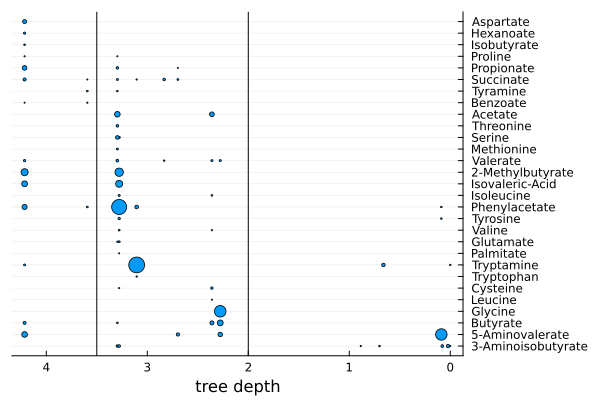

In [42]:
@df plt_sigresdf scatter(:node_depth, :metabolite_name,
    markersize=:effect_size_abs,
    label="",
    ymirror=true,
    yticks=(0.5:length(unique(:metabolite_name))- .5, unique(:metabolite_name)),
    xgrid=false,
    xflip=true,
    xlabel="tree depth",
)
vline!([3.5, 2], c=:black, label="")

In [43]:
savefig(joinpath(pdir, "bubbleplot_of_significant_metabolites_by_treedepth.pdf"))

"/Users/ben/projects/Doran_etal_2022/plots/metabolite_knn_model/bubbleplot_of_significant_metabolites_by_treedepth.pdf"

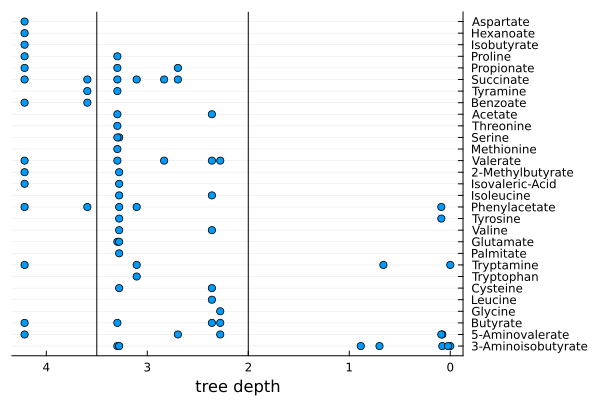

In [44]:
@df plt_sigresdf scatter(:node_depth, :metabolite_name,
    # markersize=:effect_size_abs,
    label="",
    ymirror=true,
    yticks=(0.5:length(unique(:metabolite_name))- .5, unique(:metabolite_name)),
    xgrid=false,
    xflip=true,
    xlabel="tree depth",
)
vline!([3.5, 2], c=:black, label="")

In [45]:
savefig(joinpath(pdir, "dotplot_of_significant_metabolites_by_treedepth.pdf"))

"/Users/ben/projects/Doran_etal_2022/plots/metabolite_knn_model/dotplot_of_significant_metabolites_by_treedepth.pdf"

## Make support trees

In [46]:
# (i, (fold_trn, fold_tst)) = (1, folds[1]);

In [47]:
# for (i, (fold_trn, fold_tst)) in enumerate(folds)
#     rtreepath = joinpath(rdir, "biobank-only_fold$(i)_reftree.nw")
#     btreepath = joinpath(rdir, "biobank-only_fold$(i)_boottrees.nw")
#     streepath = joinpath(rdir, "biobank-only_fold$(i)_supporttree.nw");

#     # fold_usv = svd(bbmtx_trn[fold_trn, :]);
#     fold_spi_tree = SPI.calc_spi_tree(bbmtx_trn[fold_trn, :], trnYdf.ID[fold_trn]; labelinternalnodes=false)
#     open(rtreepath, "w") do io
#         println(io, fold_spi_tree)
#     end

#     N = 100
#     fold_boot_trees = map(1:N) do i
#         features = sample(axes(bbmtx_trn, 2), size(bbmtx_trn, 2))
#         boot_tree = SPI.calc_spi_tree(
#             bbmtx_trn[fold_trn, features],
#             trnYdf.ID[fold_trn];
#             labelinternalnodes=false
#         )
#     end;
#     open(btreepath, "w") do io
#         for btree in fold_boot_trees
#             println(io, btree)
#         end
#     end
#     run(`$(gotree()) compute support booster -i $rtreepath -b $btreepath -o $streepath --silent`);    
# end

In [48]:
streepaths =  [joinpath(rdir, "biobank-only_fold$(i)_supporttree.nw") for i in 1:5]

5-element Vector{String}:
 "/Users/ben/projects/Doran_etal_" ⋯ 38 bytes ⋯ "obank-only_fold1_supporttree.nw"
 "/Users/ben/projects/Doran_etal_" ⋯ 38 bytes ⋯ "obank-only_fold2_supporttree.nw"
 "/Users/ben/projects/Doran_etal_" ⋯ 38 bytes ⋯ "obank-only_fold3_supporttree.nw"
 "/Users/ben/projects/Doran_etal_" ⋯ 38 bytes ⋯ "obank-only_fold4_supporttree.nw"
 "/Users/ben/projects/Doran_etal_" ⋯ 38 bytes ⋯ "obank-only_fold5_supporttree.nw"

In [49]:
foldtrees = readnw.(readline.(open.(streepaths)));

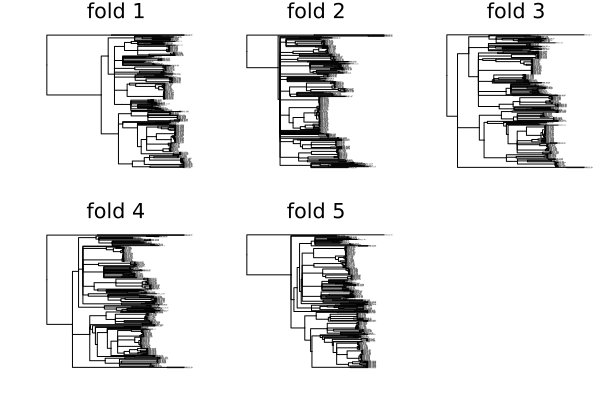

In [50]:
support = 90
ps = []
for i in 1:5
    prunedtree = NewickTreeTools.as_polytomy(n->NewickTree.support(n)<(support/100), foldtrees[i])
    NewickTreeTools.as_polytomy!(n->NewickTree.distance(n)<1e-10, prunedtree)
    push!(ps, plot(prunedtree, fs=1, title="fold $i"))
end
plot(ps..., layout=grid(2,3))

In [51]:
supports, heights = map(1:5) do i 
    mapinternalnodes(foldtrees[i]) do node
        NewickTree.support(node), NewickTree.height(node)
    end |> ((x) -> (first.(x), last.(x)));
end |> ((x) -> (first.(x), last.(x)));

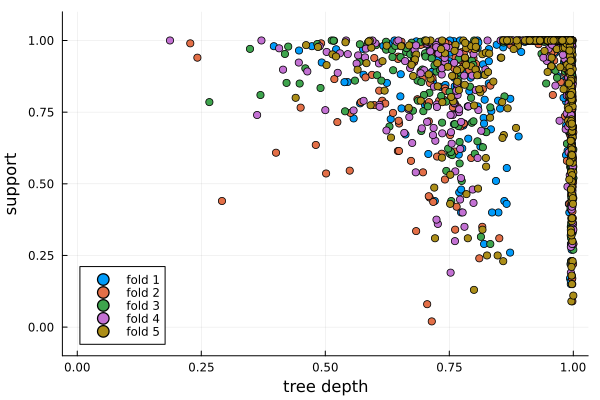

In [52]:
plot(
    ylabel="support",
    xlabel="tree depth",
    label="internal node",
    ylims=(-0.1,1.1),
    legend=:bottomleft,
)
for (i, (ss, hs)) in enumerate(zip(supports, heights))
    scatter!(hs / maximum(hs), ss, label="fold $i")
end
plot!()

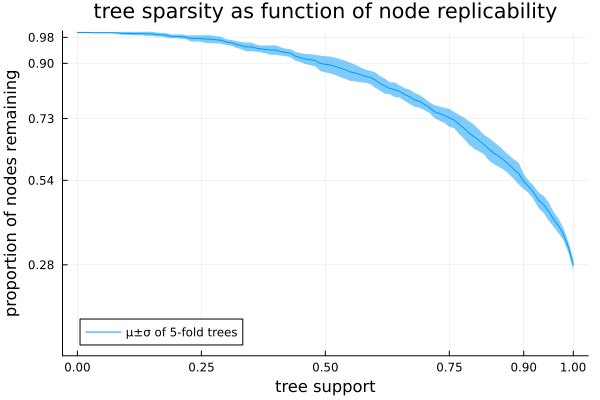

In [53]:
prop_nodesremaining = map(1:5) do f
    map(0:0.01:1) do s
        mean(supports[f] .>= s)
    end
end |> stack

plot(
    title="tree sparsity as function of node replicability",
    xlabel="tree support",
    ylabel="proportion of nodes remaining",
    ylims=(0,1),
    xticks=[0., .25, .5, .75, .9, 1.],
    yticks=round.(mean(prop_nodesremaining, dims=2)[[26, 51, 76, 91, 101]], digits=2),
    legend=:bottomleft,
)
plot!(0:0.01:1, mean(prop_nodesremaining, dims=2),
    ribbon=std(prop_nodesremaining, dims=2),
    label="μ±σ of 5-fold trees",
)

In [54]:
savefig(joinpath(pdir, "treesparsity_from_supportpruning.pdf"))

"/Users/ben/projects/Doran_etal_2022/plots/metabolite_knn_model/treesparsity_from_supportpruning.pdf"

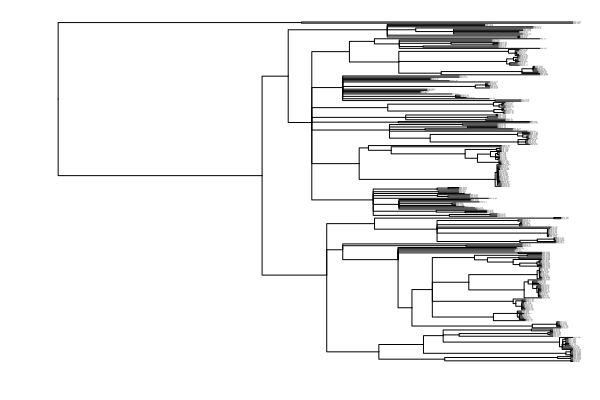

In [55]:
prunedtree = NewickTreeTools.as_polytomy(n->NewickTree.support(n)<.90, foldtrees[1])
NewickTreeTools.as_polytomy!(n->NewickTree.distance(n)<1e-10, prunedtree)
plot(prunedtree, fs=1)

## Make SPI-NN predictions

In [56]:
support = 90
prunedtrees = map(foldtrees) do tree
    prunedtree = NewickTreeTools.as_polytomy(n->NewickTree.support(n)<(support/100), tree)
end;

In [57]:
K = 1 # Make predictions with SPI-NN
all_fold_tst_preds_dfs = []
all_fold_trn_preds_dfs = []
for (i, (fold_trn, fold_tst)) in enumerate(folds)
# (i, (fold_trn, fold_tst)) = (1, folds[1])
    # calculate K nearest neighbors
    fold_usv = svd(zbbmtx_trn[fold_trn, :]);
    partitions = getintervals(fold_usv.S);
    PCs = fold_usv.U * diagm(fold_usv.S)
    search_btree = BallTree(PCs', GroupedEuclidean(getintervals(fold_usv.S)));
    proj_trn = projectinLSV(zbbmtx_trn[fold_trn, :], fold_usv) * diagm(fold_usv.S)
    proj_tst = projectinLSV(zbbmtx_trn[fold_tst, :], fold_usv) * diagm(fold_usv.S)
    trn_nns, trn_dists = knn(search_btree, proj_trn', K, true)
    tst_nns, tst_dists = knn(search_btree, proj_tst', K, true)

    # get out of fold predictions
    means_stds_tst = mapslices(stack(tst_nns), dims=1) do idx
        lnames = getleafnames(prunedtrees[i])
        foldleaves = getleaves(prunedtrees[i]);
        indexin(trnYdf.ID[fold_trn][idx], lnames) |>
            x->foldleaves[x] |>
            x->begin ans = length(x) < 2 ? parent(x[1]) : collectiveLCA(x) end |>
            getleafnames |>
            x->indexin(x, trnYdf.ID[fold_trn]) |>
            x->(vec(mean(metab_trnY[fold_trn, :][x,:], dims=1)), vec(std(metab_trnY[fold_trn, :][x,:], dims=1))) |>
            x->vcat(x...)
    end |> (x->reshape(x, 35, 2, size(x,2))) |> (x->permutedims(x, [3,1,2]))

    # get in fold predictions
    means_stds_trn = mapslices(stack(trn_nns), dims=1) do idx
        lnames = getleafnames(prunedtrees[i])
        foldleaves = getleaves(prunedtrees[i]);
        indexin(trnYdf.ID[fold_trn][idx], lnames) |> 
            x->foldleaves[x] |>
            x->begin ans = length(x) < 2 ? parent(x[1]) : collectiveLCA(x) end |>
            getleafnames |>
            x->indexin(x, trnYdf.ID[fold_trn]) |>
            x->(vec(mean(metab_trnY[fold_trn, :][x,:], dims=1)), vec(std(metab_trnY[fold_trn, :][x,:], dims=1))) |>
            x->vcat(x...)
    end |> (x->reshape(x, 35, 2, size(x,2))) |> (x->permutedims(x, [3,1,2]))

    # dataframe of predictions
    fold_tst_preds = hcat(
        DataFrame(
            hcat(repeat([i], length(fold_tst)), fold_tst,metab_trnY[fold_tst, :]),
            vcat(["fold", "row_id"], orderedmetabolites_names .* "_true")
        ),
        DataFrame(
            reshape(means_stds_tst, :, 70),
            vcat(orderedmetabolites_names .* "_pred_mean", orderedmetabolites_names .* "_pred_std")
        )
    )

    fold_trn_preds = hcat(
        DataFrame(
            hcat(repeat([i], length(fold_trn)), fold_trn,metab_trnY[fold_trn, :]),
            vcat(["fold", "row_id"], orderedmetabolites_names .* "_true")
        ),
        DataFrame(
            reshape(means_stds_trn, :, 70),
            vcat(orderedmetabolites_names .* "_pred_mean", orderedmetabolites_names .* "_pred_std")
        )
    )
    push!(all_fold_tst_preds_dfs, fold_tst_preds)
    push!(all_fold_trn_preds_dfs, fold_trn_preds)

end

In [58]:
oof_preds_df = vcat(all_fold_tst_preds_dfs...)
infold_preds_df = vcat(all_fold_tst_preds_dfs...);
CSV.write(joinpath(rdir, savename("infold_preds_", (K=K, nboot=100, support=support), "csv")), infold_preds_df)
CSV.write(joinpath(rdir, savename("oof_preds_", (K=K, nboot=100, support=support), "csv")), oof_preds_df)

"/Users/ben/projects/Doran_etal_2022/_research/metabolite_knn_model/oof_preds__K=1_nboot=100_support=90.csv"

In [1008]:
# oof_preds_df = CSV.read(joinpath(rdir, "oof_preds__K=3_nboot=100_support=90.csv"), DataFrame);

## Show SPI-NN prediction results

In [1009]:
metabolite_name = "Acetate"
# metabolite_name = "Butyrate"

# metabolite_name = "Lysine"
# metabolite_name = "Desaminotyrosine"
# metabolite_name = "Phenol"

"Acetate"

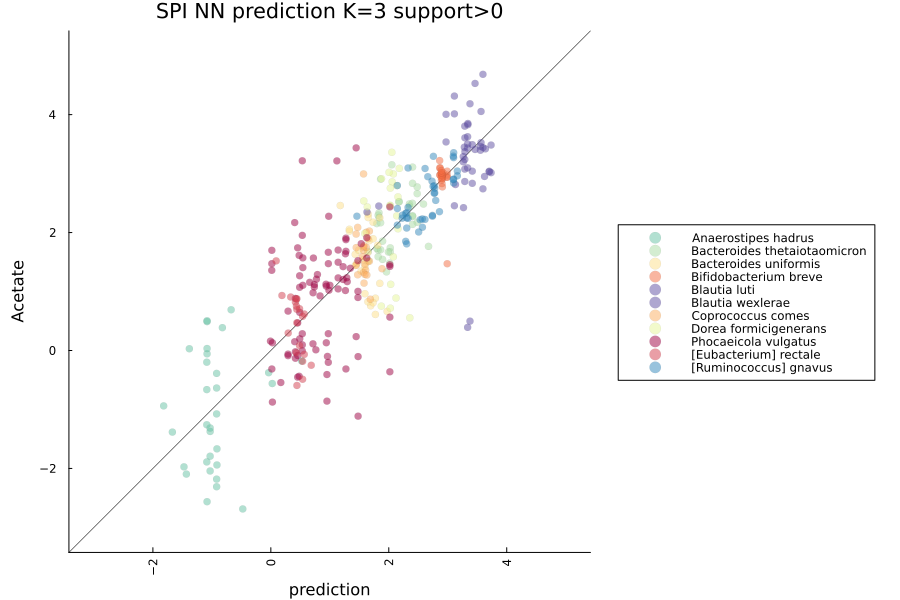

In [1010]:
preds_knn = oof_preds_df[:, metabolite_name * "_pred_mean"]
preds_std = oof_preds_df[:, metabolite_name * "_pred_std"]
truth = oof_preds_df[:, metabolite_name * "_true"]
species = trnYdf.species[Int.(oof_preds_df.row_id)];

lims = extrema(vcat(preds_knn, truth))
lims =  lims .+ (-(lims[2] - lims[1]) * 0.1, (lims[2] - lims[1]) * 0.1)
plot((x)->x, [-20, 20], c=:black, lw=.5, label="")
p1 = scatter!(preds_knn, truth,
    group=species,
    lims=lims,
    title="SPI NN prediction K=$(K) support>$support",
    ylabel=metabolite_name,
    xlabel="prediction",
    grid=false,
    markerstrokewidth=0,
    ratio=1,
    c=speciescolors_ordered,
    size=(900,600),
    legend=:outerright,
    xrotation=90,
    alpha=.5,
)

In [449]:
savefig(joinpath(pdir, "$(metabolite_name)_scatter_predictions_knn_model_K=$(K)_support=$(support).pdf"))

"/Users/ben/projects/Doran_etal_2022/plots/metabolite_knn_model/Lysine_scatter_predictions_knn_model_K=3_support=90.pdf"

In [404]:
lasso_oof_preds_df = CSV.read(projectdir("_research/metabolite_lasso_model/oof_lasso_preds_lambda=0.01.csv"), DataFrame);

In [450]:
mergeddf = leftjoin(oof_preds_df, lasso_oof_preds_df, on=:row_id, makeunique=true);

In [479]:
preds_knn = mergeddf[:, metabolite_name * "_pred_mean"]
preds_full = mergeddf[:, metabolite_name * "_pred_full"]
preds_top10 = mergeddf[:, metabolite_name * "_pred_top10"]
preds_top3 = mergeddf[:, metabolite_name * "_pred_top3"]
preds_std = mergeddf[:, metabolite_name * "_pred_std"]
truth = mergeddf[:, metabolite_name * "_true"]
species = trnYdf.species[Int.(mergeddf.row_id)];

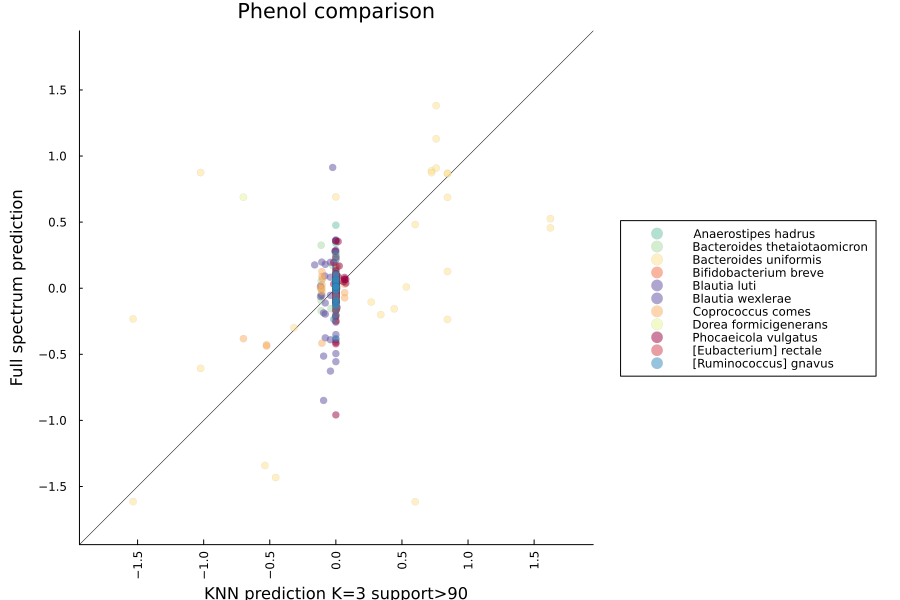

In [480]:
lims = extrema(vcat(preds_knn, preds_full))
lims =  lims .+ (-(lims[2] - lims[1]) * 0.1, (lims[2] - lims[1]) * 0.1)
plot((x)->x, [-20, 20], c=:black, lw=.5, label="")
p1 = scatter!(preds_knn, preds_full,
    group=species,
    lims=lims,
    title="$metabolite_name comparison",
    ylabel="Full spectrum prediction",
    xlabel="KNN prediction K=$K support>$(support)",
    grid=false,
    markerstrokewidth=0,
    ratio=1,
    c=speciescolors_ordered,
    size=(900,600),
    legend=:outerright,
    xrotation=90,
    alpha=.5,
)

In [408]:
savefig(joinpath(pdir, "$(metabolite_name)_comparison_knn_to_full_K=$(K)_support=$(support).pdf"))

"/Users/ben/projects/Doran_etal_2022/plots/metabolite_knn_model/Acetate_comparison_knn_to_full_K=3_support=90.pdf"

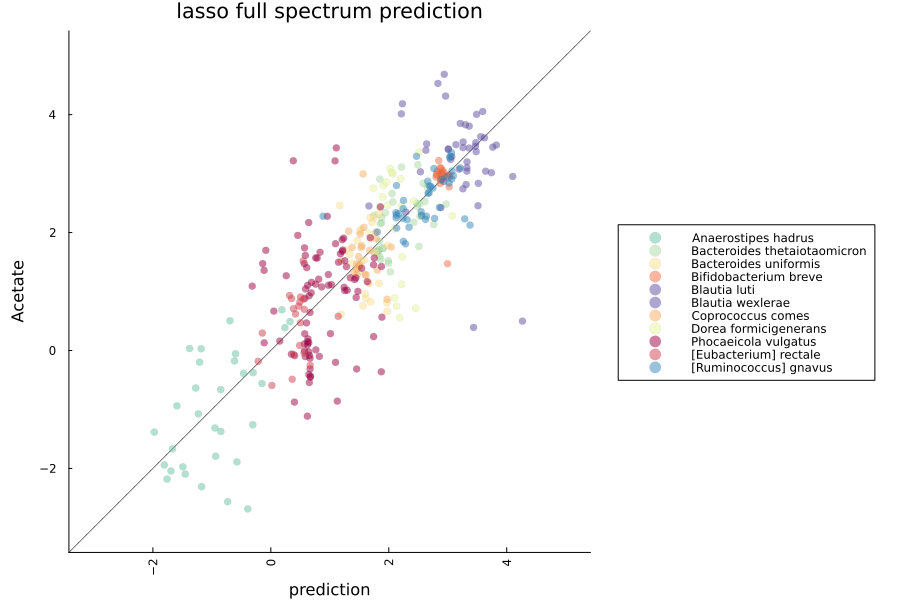

In [ ]:
preds_full = mergeddf[:, metabolite_name * "_pred_full"]
# preds_std = mergeddf[:, metabolite_name * "_pred_std"]
truth = mergeddf[:, metabolite_name * "_true"]
species = trnYdf.species[Int.(mergeddf.row_id)];

lims = extrema(vcat(preds_full, truth))
lims =  lims .+ (-(lims[2] - lims[1]) * 0.1, (lims[2] - lims[1]) * 0.1)
plot((x)->x, [-20, 20], c=:black, lw=.5, label="")
p1 = scatter!(preds_full, truth,
    group=species,
    lims=lims,
    title="lasso full spectrum prediction",
    ylabel=metabolite_name,
    xlabel="prediction",
    grid=false,
    markerstrokewidth=0,
    ratio=1,
    c=speciescolors_ordered,
    size=(900,600),
    legend=:outerright,
    xrotation=90,
    alpha=.5,
    # legendfontsize=6,
)

## R squared

In [549]:
rsquaredoflassovsspinn = map(orderedmetabolites_names[keepmetabolites_mask]) do mname
    rsquared(
        mergeddf[:, mname * "_pred_full"], 
        mergeddf[:, mname * "_pred_mean"], 
    )
end

29-element Vector{Float64}:
 0.8768012797754711
 0.6970834844058603
 0.877680652048989
 0.7343573739786753
 0.6857255802265199
 0.8711829900068704
 0.5760520753464832
 0.718451919639721
 0.9114834069023858
 0.9323828738616934
 ⋮
 0.49464427220974794
 0.7599361421640117
 0.5407118875738448
 0.7028908980880013
 0.684023406896245
 0.7355326583633962
 0.6371731061616143
 0.7040883900985364
 0.5211232464531634

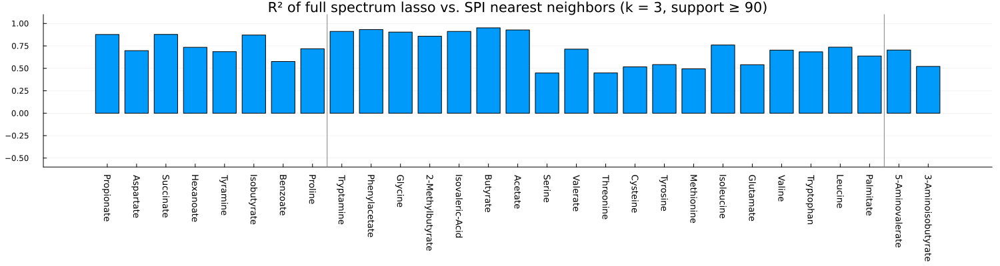

In [551]:
bar(rsquaredoflassovsspinn,
    # errorbar=corrbias_stds,
    ylims=(-0.6, 1.1),
    yticks=-.5:.25:1,
    xticks=(1:length(rsquaredoflassovsspinn), orderedmetabolites_names[keepmetabolites_mask]),
    xtickfontsize=9,
    xrotation=-90,
    title="R² of full spectrum lasso vs. SPI nearest neighbors (k = $K, support ≥ $support)",
    label="R²",
    xgrid=false,
    size=(1500, 400),
    bottommargin=25Plots.Measures.mm,
    legend=:none,
)
vline!([8.5, 8+19+.5], c=:grey, label="")

In [552]:
savefig(joinpath(pdir, "Rsquared_of_fulllasso_vs_SPI-NN_K=$(K)_support=$(support).pdf"))

"/Users/ben/projects/Doran_etal_2022/plots/metabolite_knn_model/Rsquared_of_fulllasso_vs_SPI-NN_K=3_support=90.pdf"

## Metric of residuals

In [503]:
keepmetabolites_mask = mapslices(c->mean(c .==0.) < .9, metab_trnY,dims=1)|>vec;

In [1011]:
metabolite_name = "Acetate"
# metabolite_name = "Butyrate"
# metabolite_name = "Hexanoate"

# metabolite_name = "Lysine"
# metabolite_name = "Desaminotyrosine"
# metabolite_name = "Phenol"

"Acetate"

In [1012]:
preds_knn = mergeddf[:, metabolite_name * "_pred_mean"]
preds_full = mergeddf[:, metabolite_name * "_pred_full"]
preds_top10 = mergeddf[:, metabolite_name * "_pred_top10"]
preds_top3 = mergeddf[:, metabolite_name * "_pred_top3"]
preds_std = mergeddf[:, metabolite_name * "_pred_std"]
truth = mergeddf[:, metabolite_name * "_true"]
species = trnYdf.species[Int.(mergeddf.row_id)];

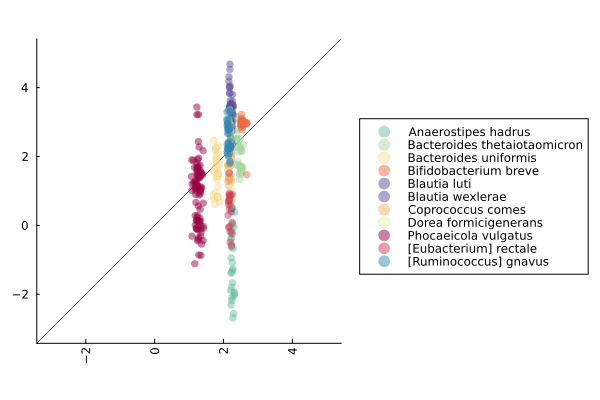

In [1013]:
lims = extrema(vcat(truth, preds_top3))
lims =  lims .+ (-(lims[2] - lims[1]) * 0.1, (lims[2] - lims[1]) * 0.1)
plot((x)->x, [-20, 20], c=:black, lw=.5, label="")
p1 = scatter!(preds_top3, truth,
    group=species,
    lims=lims,
    # title="$metabolite_name comparison",
    # ylabel="Full spectrum prediction",
    # xlabel="KNN prediction K=$K support>$(support)",
    grid=false,
    markerstrokewidth=0,
    ratio=1,
    c=speciescolors_ordered,
    size=(600,400),
    legend=:outerright,
    xrotation=90,
    alpha=.5,
)

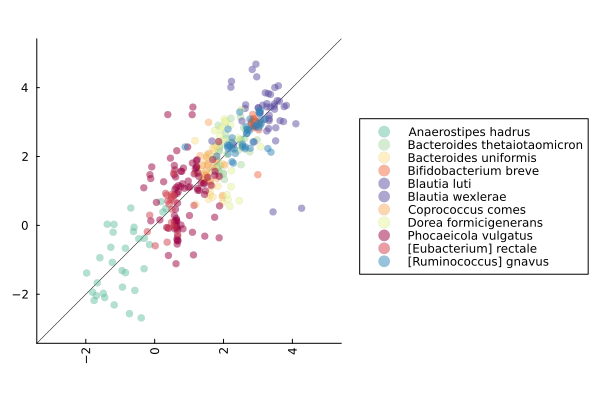

In [1014]:
lims = extrema(vcat(truth, preds_full))
lims =  lims .+ (-(lims[2] - lims[1]) * 0.1, (lims[2] - lims[1]) * 0.1)
plot((x)->x, [-20, 20], c=:black, lw=.5, label="")
p1 = scatter!(preds_full, truth,
    group=species,
    lims=lims,
    # title="$metabolite_name comparison",
    # ylabel="Full spectrum prediction",
    # xlabel="KNN prediction K=$K support>$(support)",
    grid=false,
    markerstrokewidth=0,
    ratio=1,
    c=speciescolors_ordered,
    size=(600,400),
    legend=:outerright,
    xrotation=90,
    alpha=.5,
)

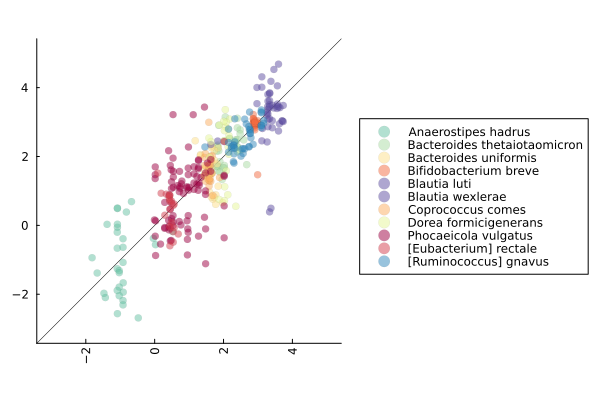

In [1015]:
lims = extrema(vcat(truth, preds_knn))
lims =  lims .+ (-(lims[2] - lims[1]) * 0.1, (lims[2] - lims[1]) * 0.1)
plot((x)->x, [-20, 20], c=:black, lw=.5, label="")
p1 = scatter!(preds_knn, truth,
    group=species,
    lims=lims,
    # title="$metabolite_name comparison",
    # ylabel="Full spectrum prediction",
    # xlabel="KNN prediction K=$K support>$(support)",
    grid=false,
    markerstrokewidth=0,
    ratio=1,
    c=speciescolors_ordered,
    size=(600,400),
    legend=:outerright,
    xrotation=90,
    alpha=.5,
)

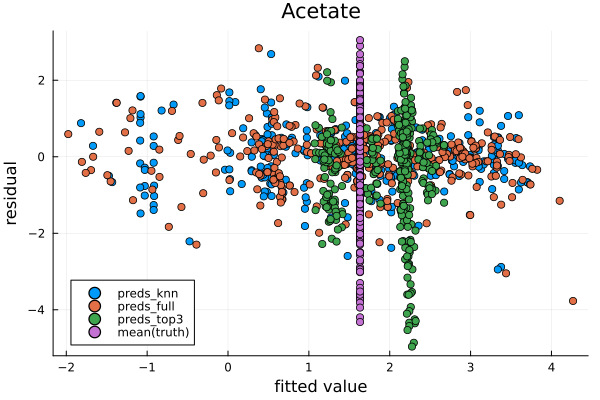

In [1016]:
plot(
    title=metabolite_name,
    xlabel="fitted value",
    ylabel="residual",
)
scatter!(preds_knn, truth .- preds_knn, label="preds_knn")
scatter!(preds_full, truth .- preds_full, label="preds_full")
scatter!(preds_top3, truth .- preds_top3, label="preds_top3")
scatter!(repeat([mean(truth)], length(truth)), truth .- mean(truth), label="mean(truth)")

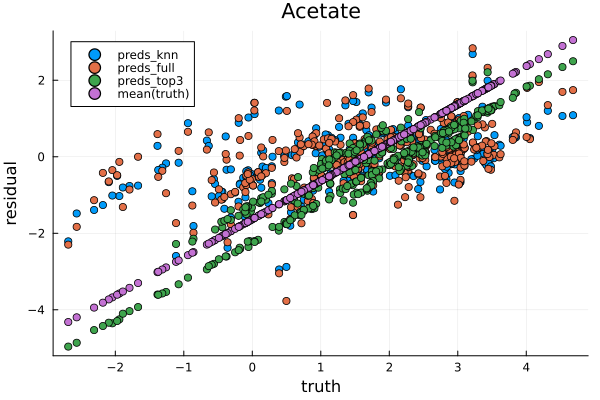

In [1017]:
plot(
    title=metabolite_name,
    xlabel="truth",
    ylabel="residual",
)
scatter!(truth, truth .- preds_knn, label="preds_knn")
scatter!(truth, truth .- preds_full, label="preds_full")
scatter!(truth, truth .- preds_top3, label="preds_top3")
scatter!(truth, truth .- mean(truth), label="mean(truth)")

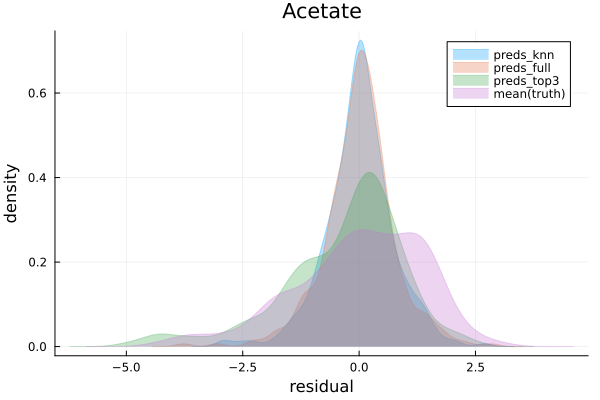

In [1018]:
plot(
    title=metabolite_name,
    xlabel="residual",
    ylabel="density",
)
density!(truth, truth .- preds_knn, label="preds_knn", fill=0, alpha=.3)
density!(truth, truth .- preds_full, label="preds_full", fill=0, alpha=.3)
density!(truth, truth .- preds_top3, label="preds_top3", fill=0, alpha=.3)
density!(truth, truth .- mean(truth), label="mean(truth)", fill=0, alpha=.3)

In [1019]:
mnames = string.(orderedmetabolites_names[keepmetabolites_mask]);

In [1075]:
# nrmse(y, ŷ) = rmse(y, ŷ) / mean(y)
nrmse(y, ŷ) = rmse(y, ŷ) / std(y)
function get_scores(fun, df, predname, groupcol=:fold) 
    combine(groupby(df, groupcol)) do gdf 
        ŷs = gdf[:, Cols(mnames .* "_pred_".* predname)]
        ys = gdf[:, Cols(mnames .* "_true")]
        scores = map(zip(eachcol(ŷs), eachcol(ys))) do (ŷ, y)
            fun(ŷ, y)
        end |> permutedims
        scores
    end |>
    Matrix |>
    x->getindex(x, :, axes(x,2)[2:end]) |>
    permutedims
end

get_scores (generic function with 2 methods)

In [1065]:
lasso_oof_preds_df[!, "species"] = trnYdf.species[lasso_oof_preds_df.row_id]
oof_preds_df[!, "species"] = trnYdf.species[Int.(oof_preds_df.row_id)];

In [1066]:
scores = get_scores(func, lasso_oof_preds_df, "full", "species");

In [1076]:
meanstderr(ŷ, y) = 1 - sum(skipinvalid((ŷ .- y).^2)) / sum(skipinvalid((mean(y) .- y).^2))
# meanstderr(y, ŷ) = 1 - rsquared(y, ŷ)

meanstderr (generic function with 1 method)

In [1077]:
rsquared(truth, preds_full)

0.6188312634297894

In [1078]:
rsquared(preds_full, truth)

0.6963142287802802

In [1128]:
func = rsquared

all_scores = map(["full", "top3"]) do type
    scores = get_scores(func, lasso_oof_preds_df, type, "fold")
    mean(scores, dims=2), std(scores, dims=2)
end
knn_scores = map(["mean"]) do type
    scores = get_scores(func, oof_preds_df, type, "fold")
    mean(scores, dims=2)|>vec, std(scores, dims=2)|>vec
end
scores_means = hcat(first.(knn_scores)..., first.(all_scores)...)
scores_stds = hcat(last.(knn_scores)..., last.(all_scores)...);

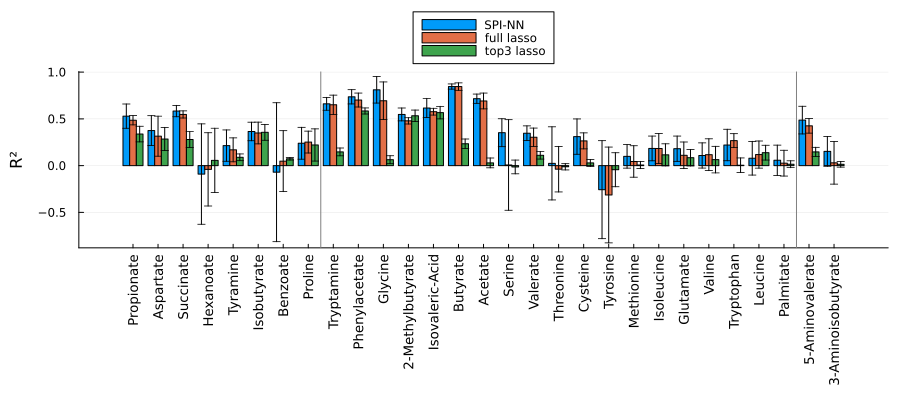

In [1181]:
groupedbar(scores_means,
    errorbar=scores_stds,
    xticks=(1:length(mnames), mnames),
    xtickfontsize=9,
    xrotation=90,
    ylabel="R²",
    # label=["SPI-NN" "full lasso" "top10 lasso" "top3 lasso"],
    label=["SPI-NN" "full lasso" "top3 lasso"],
    xgrid=false,
    size=(900, 400),
    leftmargin=.5Plots.Measures.cm,
    bottommargin=2Plots.Measures.cm,
    legend=:outertop,
)
vline!([8.5, 8+19+.5], c=:grey, label="")

In [1182]:
savefig(joinpath(pdir, "Rsquared_of_allmetabolites_and_all_models.pdf"))

"/Users/ben/projects/Doran_etal_2022/plots/metabolite_knn_model/Rsquared_of_allmetabolites_and_all_models.pdf"

In [1084]:
func = rsquared

all_scores_perfold = map(["full", "top10", "top3"]) do type
    scores = get_scores(func, lasso_oof_preds_df, type, "fold")
end
knn_scores_perfold = map(["mean"]) do type
    scores = get_scores(func, oof_preds_df, type, "fold")
end

1-element Vector{Matrix{Float64}}:
 [0.616103193253929 0.6991527333337462 … 0.4133654626596345 0.5185065317877038; 0.1408989224238092 0.5776203173145309 … 0.3647093588550101 0.3435580342342095; … ; 0.6194647024502284 0.5635915649767305 … 0.5669690565137685 0.4299002789369222; 0.25505983332592297 0.22310472301536288 … -0.09393958810503533 0.08339064049095823]

In [1088]:
using HypothesisTests
using MultipleTesting: adjust, Bonferroni, BenjaminiHochberg

In [1130]:
allscores_perfold = vcat(permutedims(stack(knn_scores_perfold), [3,1,2]), permutedims(stack(all_scores_perfold), [3,1,2]));

Select all metabolites where either both SBA-knn and top3 PCs work or SBA-knn is significantly better than top3 model

In [1165]:
poweroftest = mapslices(allscores_perfold, dims=(1,3)) do m
        pvalue(UnequalVarianceTTest(m[1, :], m[4, :]))
    end |> 
    x->dropdims(x, dims=(1,3)) |>
    p->adjust(p, BenjaminiHochberg()) |> 
    p->filter(<(0.05), p) |>
    p->floor.(Int, log10.(1 ./ p))

bothmodelswork = (scores_means[:, end] .> 0.5) .& (scores_means[:, begin] .> 0.5) |> findall
issig = mapslices(allscores_perfold, dims=(1,3)) do m
        pvalue(UnequalVarianceTTest(m[1, :], m[4, :]))
    end |> 
    x->dropdims(x, dims=(1,3)) |>
    p->adjust(p, BenjaminiHochberg()) |>
    # p->adjust(p, Bonferroni()) |>
    p -> (p .< 0.05) |>
    findall
rsq_test_mask = vcat(issig, bothmodelswork);

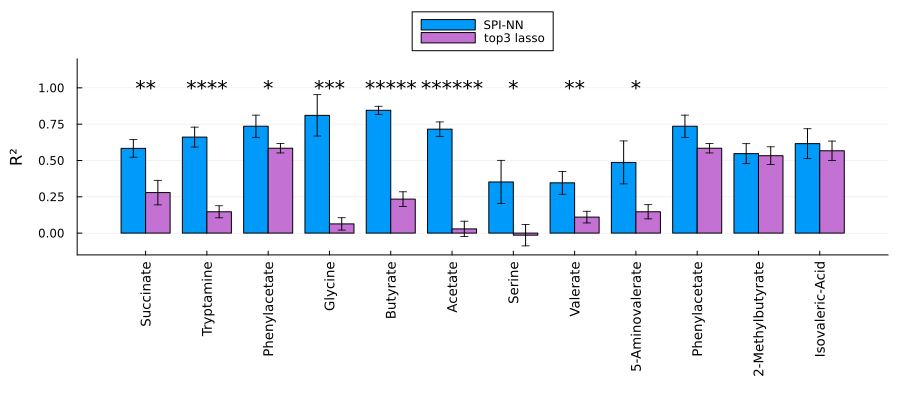

In [1177]:
groupedbar(scores_means[rsq_test_mask, [begin,end]],
    errorbar=scores_stds[rsq_test_mask, [begin,end]],
    xticks=(1:length(mnames[rsq_test_mask]), mnames[rsq_test_mask]),
    xtickfontsize=9,
    xrotation=90,
    ylabel="R²",
    ylims=(-.15, 1.2),
    # label=["SPI-NN" "full lasso" "top10 lasso" "top3 lasso"],
    label=["SPI-NN" "top3 lasso"],
    xgrid=false,
    size=(900, 400),
    leftmargin=.5Plots.Measures.cm,
    bottommargin=2Plots.Measures.cm,
    legend=:outertop,
    c=[1 4],
)
annotate!(1:length(issig), repeat([1], length(issig)), repeat.("*", poweroftest))
# vline!([8.5, 8+19+.5], c=:grey, label="")

In [1178]:
savefig(joinpath(pdir, "Barplot_significantly-improved-metabolites_SPINN-top3Lasso.pdf"))

"/Users/ben/projects/Doran_etal_2022/plots/metabolite_knn_model/Barplot_significantly-improved-metabolites_SPINN-top3Lasso.pdf"

In [1191]:
pltdict = Dict(
    "show improvement" => length(issig),
    "no significant improvement" => size(scores_means, 1) - length(issig),
)

Dict{String, Int64} with 2 entries:
  "show improvement"           => 9
  "no significant improvement" => 20

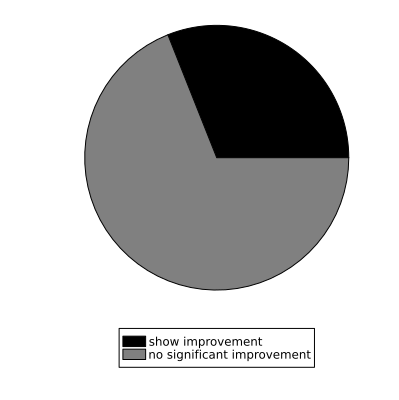

In [1209]:
pie(pltdict,
    legend=:outerbottom,
    c = [:black, :grey],
    # c = [1, 4],
    size=(400, 400),
)

In [1210]:
savefig(joinpath(pdir, "piechart_proportion-of-significantly-improved-metabolites_SPINN-top3Lasso.pdf"))

"/Users/ben/projects/Doran_etal_2022/plots/metabolite_knn_model/piechart_proportion-of-significantly-improved-metabolites_SPINN-top3Lasso.pdf"